In [1]:
import numpy as np
import pandas as pd
import sklearn
import matplotlib
import matplotlib.pyplot as plt
import plotly.express as px

### Loading CytoTrace2 results

In [2]:
cytotrace2_results = pd.read_table("cytotrace2/cytotrace2_results.txt", index_col=0)
cytotrace2_results.head()

,CytoTRACE2_Score,CytoTRACE2_Potency,CytoTRACE2_Relative,preKNN_CytoTRACE2_Score,preKNN_CytoTRACE2_Potency
iM_data_GTGGAAGGTCAATGGG-1,0.416826,Oligopotent,0.143810,0.347394,Oligopotent
iM_data_TTCATGTCAACCCGCA-1,0.384175,Oligopotent,0.031948,0.333333,Oligopotent
iM_data_GAGGGTATCCAGGACC-1,0.391456,Oligopotent,0.055442,0.340629,Oligopotent
iM_data_AAGTCGTAGGCTTTCA-1,0.411235,Oligopotent,0.123248,0.342250,Oligopotent
iM_data_ACCGTTCGTAACTTCG-1,0.422017,Oligopotent,0.161059,0.440175,Oligopotent


### Apply scEGOT

In [3]:
import os
import glob
import itertools

import pandas as pd
import anndata

from scegot import scEGOT

In [4]:
DATASET_INPUT_ROOT_PATH = os.path.join("../data/")
ANNDATA_DATASET_PATH = os.path.join(
    DATASET_INPUT_ROOT_PATH, "scRNAseq_hPGCLC_induction_Saitou.h5ad"
)
# CSV_DATASET_FOLDER_PATH = os.path.join(DATASET_INPUT_ROOT_PATH, "csv_folder/")
RANDOM_STATE = 2023
PCA_N_COMPONENTS = 150
GMM_CLUSTER_NUMBERS = [1, 2, 4, 5, 5]
UMAP_N_NEIGHBORS = 1000
DAY_NAMES = ["day0", "day0.5", "day1", "day1.5", "day2"]

In [5]:
# ----- In the case of AnnData -----
input_data = anndata.read_h5ad(ANNDATA_DATASET_PATH)
print(input_data)
display(input_data.X)
display(input_data.obs)
display(input_data.var)

# ----- In the case of DataFrame (CSV) -----
# input_file_paths = sorted(glob.glob(f"{CSV_DATASET_FOLDER_PATH}*.csv"))
# input_data = [
#     pd.read_csv(input_file_path, index_col=0) for input_file_path in input_file_paths
# ]
# print(f"number of days: {len(input_data)}")
# print("shape of each day's data:")
# for i, data in enumerate(input_data):
#     print(f"    {DAY_NAMES[i]}: {data.shape}")
# print("data example: ")
# input_data[0].head()

AnnData object with n_obs × n_vars = 11771 × 18922
    obs: 'sample', 'percent.mito', 'day', 'cluster_day'
    var: 'spliced', 'unspliced', 'mt', 'TF', 'gene_name'
    layers: 'X_raw', 'spliced', 'unspliced'


<11771x18922 sparse matrix of type '<class 'numpy.float32'>'
	with 94477374 stored elements in Compressed Sparse Row format>

,sample,percent.mito,day,cluster_day
iM.data_GTGGAAGGTCAATGGG-1,iM.data,0.056487,iM,day0
iM.data_TTCATGTCAACCCGCA-1,iM.data,0.216231,iM,day0
iM.data_GAGGGTATCCAGGACC-1,iM.data,0.076525,iM,day0
iM.data_AAGTCGTAGGCTTTCA-1,iM.data,0.080264,iM,day0
iM.data_ACCGTTCGTAACTTCG-1,iM.data,0.280788,iM,day0
...,...,...,...,...
d2b.data_AAGCCATAGGGCGAGA-1,d2b.data,4.811476,d2b,day2
d2b.data_CAACCAATCTTCCGTG-1,d2b.data,2.554428,d2b,day2
d2b.data_AGGCCACGTGAGTAGC-1,d2b.data,3.142146,d2b,day2
d2b.data_GATCAGTTCGAGTACT-1,d2b.data,4.287140,d2b,day2


,spliced,unspliced,mt,TF,gene_name
FAM3A,1,1,0,0,FAM3A
SLC25A1,1,1,0,0,SLC25A1
RBL1,1,1,0,0,RBL1
PPP2R1A,1,1,0,0,PPP2R1A
H3F3B,1,1,0,0,H3F3B
...,...,...,...,...,...
OR2W5,1,0,0,0,OR2W5
ODF4,1,1,0,0,ODF4
CRP,1,0,0,0,CRP
KRTAP4-9,1,0,0,0,KRTAP4-9


In [6]:
# ----- In the case of AnnData -----
scegot = scEGOT(
    input_data,
    verbose=True,  # default=True
    adata_day_key="cluster_day",
)

# ----- In the case of DataFrame (CSV) -----
# scegot = scEGOT(
#     input_data,
#     verbose=True,  # default=True
#     day_names=DAY_NAMES, # uncomment this line if you use an array of DataFrames
# )

Processing AnnData...


In [7]:
%%time
X, pca_model = scegot.preprocess(
    PCA_N_COMPONENTS,
    recode_params={},
    umi_target_sum=1e5,
    pca_random_state=RANDOM_STATE,
    pca_other_params={},
    apply_recode=True,
    apply_normalization_log1p=True,
    apply_normalization_umi=True,
    select_genes=True,
    n_select_genes=2000,
)

Applying RECODE...
start RECODE for scRNA-seq data
end RECODE for scRNA-seq
log: {'seq_target': 'RNA', '#significant genes': 15820, '#non-significant genes': 2582, '#silent genes': 65, 'ell': 288, 'Elapsed time': '0h 0m 25s 122ms', 'solver': 'randomized', '#test_data': 2354}
Applying UMI normalization...
Applying log1p normalization...
Applying PCA...
	sum of explained_variance_ratio = 93.67122272048897
CPU times: user 1min 55s, sys: 15 s, total: 2min 10s
Wall time: 34.9 s


In [8]:
%%time
gmm_models, gmm_labels = scegot.fit_predict_gmm(
    n_components_list=GMM_CLUSTER_NUMBERS,
    covariance_type="full",
    max_iter=2000,
    n_init=10,
    random_state=RANDOM_STATE,
    gmm_other_params={},
)

Fitting GMM models with each day's data and predicting labels for them...


100%|██████████| 5/5 [00:19<00:00,  3.81s/it]

CPU times: user 1min 54s, sys: 56.4 s, total: 2min 50s
Wall time: 19.2 s


In [9]:
%%time
X_umap, umap_model = scegot.apply_umap(
    UMAP_N_NEIGHBORS,
    n_components=2,
    random_state=RANDOM_STATE,
    min_dist=0.8,
    umap_other_params={},
)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


CPU times: user 2min 8s, sys: 1min 18s, total: 3min 27s
Wall time: 1min


In [10]:
%%time
Wpotential, F_all = scegot.calculate_waddington_potential(
    n_neighbors=100,
    knn_other_params={},
)

Calculating F between each day...


100%|██████████| 4/4 [00:05<00:00,  1.36s/it]


Applying knn ...
Computing kernel ...
CPU times: user 57.4 s, sys: 9.22 s, total: 1min 6s
Wall time: 8.6 s


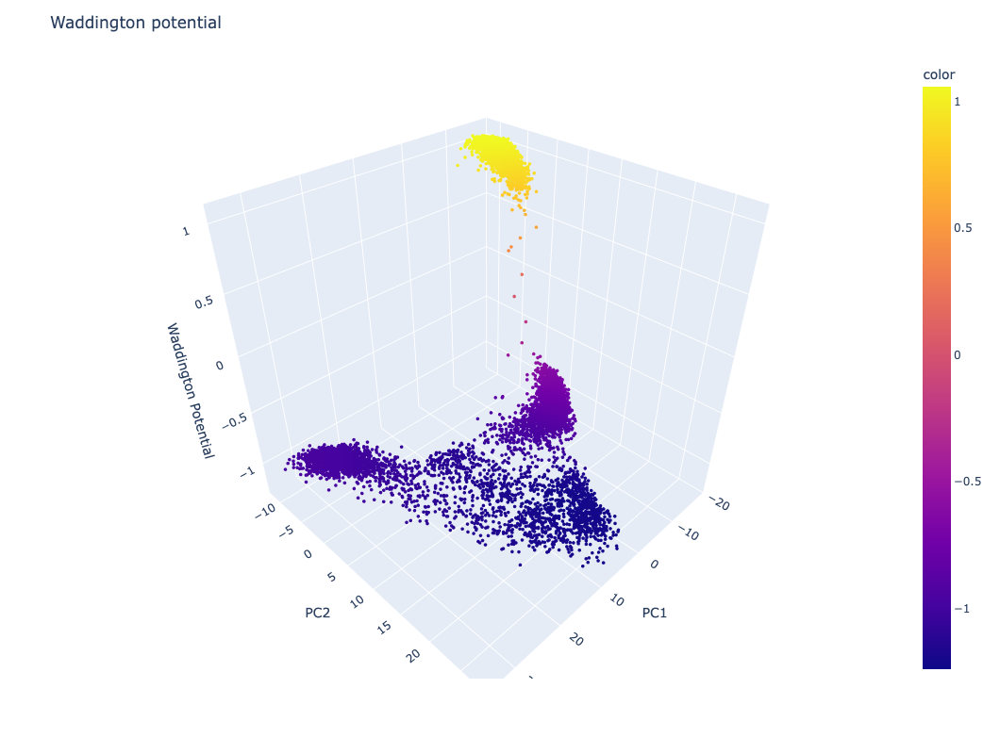

In [11]:
scegot.plot_waddington_potential(
    Wpotential,
    mode="pca",
    gene_name=None,
    # save=True,
    # save_path="./waddington_potential_pca_potential.html"
)

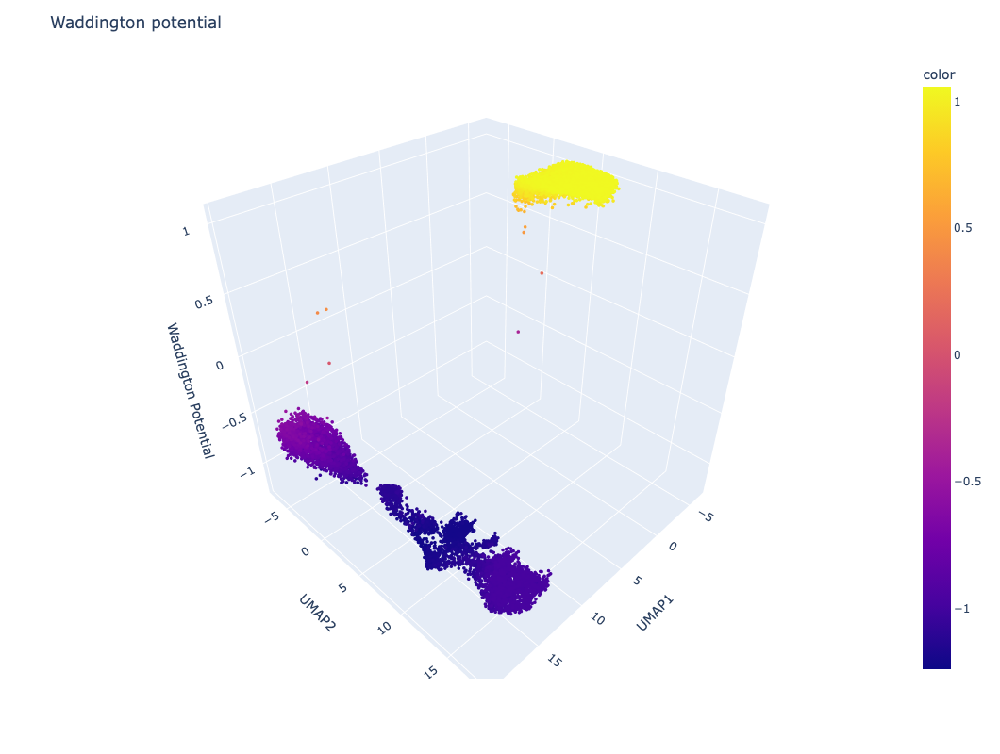

In [12]:
scegot.plot_waddington_potential(
    Wpotential,
    mode="umap",
    gene_name=None,
    # save=True,
    # save_path="./waddington_potential_umap_potential.html"
)

### Making comparison images

#### 2-d

##### PCA

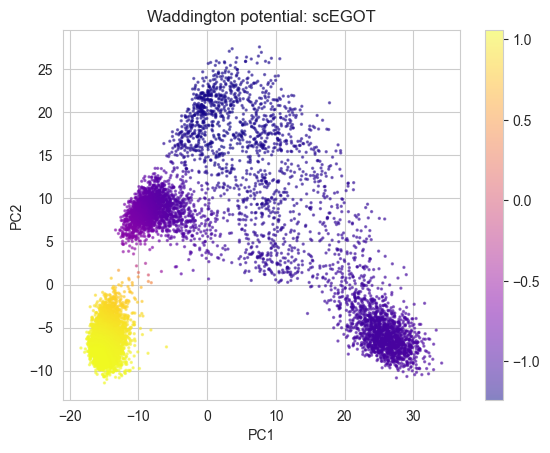

In [14]:
plt.scatter(
    pd.concat(scegot.X_pca[:-1]).iloc[:, 0],
    pd.concat(scegot.X_pca[:-1]).iloc[:, 1],
    c=Wpotential,
    cmap="plasma",
    s=2,
    alpha=0.5,
)
plt.colorbar()
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("Waddington potential: scEGOT")
plt.savefig("../figure/potential_scEGOT_pca.jpeg", format="jpeg", dpi=300, bbox_inches="tight")

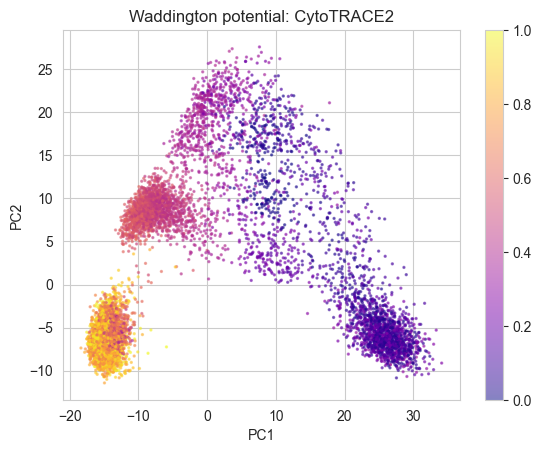

In [15]:
#plt.scatter(
#    pd.concat(scegot.X_pca[:-1]).iloc[:, 0],
#    pd.concat(scegot.X_pca[:-1]).iloc[:, 1],
#    c=cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])].values,
#    cmap="plasma",
#    s=2,
#    alpha=0.5,
#)
#plt.colorbar()
#plt.xlabel("PC1")
#plt.ylabel("PC2")
#plt.title("Waddington potential - CytoTRACE2")
#plt.show()

# 1 - CytoTRACE2_Relative plot
plt.scatter(
    pd.concat(scegot.X_pca[:-1]).iloc[:, 0],
    pd.concat(scegot.X_pca[:-1]).iloc[:, 1],
    c=1 - cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])].values,
    cmap="plasma",
    s=2,
    alpha=0.5,
)
plt.colorbar()
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("Waddington potential: CytoTRACE2")
plt.savefig("../figure/potential_CytoTRACE2_pca.jpeg", format="jpeg", dpi=300, bbox_inches="tight")

##### UMAP

Text(0.5, 1.0, 'Waddington potential: scEGOT')

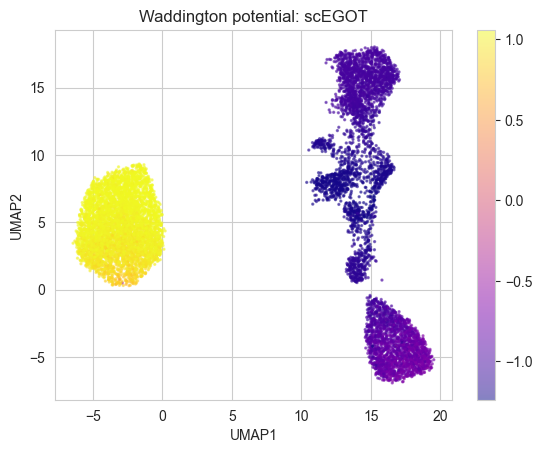

In [16]:
plt.scatter(
    pd.concat(scegot.X_umap[:-1]).iloc[:, 0],
    pd.concat(scegot.X_umap[:-1]).iloc[:, 1],
    c=Wpotential,
    cmap="plasma",
    s=2,
    alpha=0.5,
)
plt.colorbar()
plt.xlabel("UMAP1")
plt.ylabel("UMAP2")
plt.title("Waddington potential: scEGOT")

Text(0.5, 1.0, 'Waddington potential: CytoTRACE2')

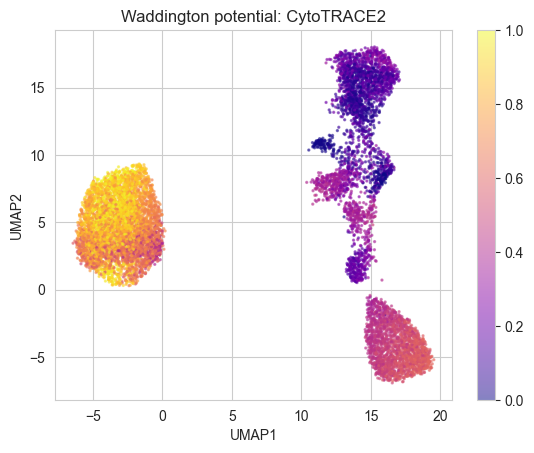

In [17]:
#plt.scatter(
#    pd.concat(scegot.X_umap[:-1]).iloc[:, 0],
#    pd.concat(scegot.X_umap[:-1]).iloc[:, 1],
#    c=cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])].values,
#    cmap="plasma",
#    s=2,
#    alpha=0.5,
#)
#plt.colorbar()
#plt.xlabel("UMAP1")
#plt.ylabel("UMAP2")
#plt.title("Waddington potential - CytoTRACE2")
#plt.show()

# 1 - CytoTRACE2_Relative plot
plt.scatter(
    pd.concat(scegot.X_umap[:-1]).iloc[:, 0],
    pd.concat(scegot.X_umap[:-1]).iloc[:, 1],
    c=1
    - cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])].values,
    cmap="plasma",
    s=2,
    alpha=0.5,
)
plt.colorbar()
plt.xlabel("UMAP1")
plt.ylabel("UMAP2")
plt.title("Waddington potential: CytoTRACE2")

#### 3-d

##### PCA

In [18]:
def create_graph(
    X,
    cutedge_vol=None,
    cutedge_length=None,
    cut_std=None,
    return_type="edges",
):
    tri_ = matplotlib.tri.Triangulation(X[:, 0], X[:, 1])
    X_src_, X_trg_ = X[tri_.edges[:, 0]], X[tri_.edges[:, 1]]
    length_edge_ = np.linalg.norm(X_src_ - X_trg_, axis=1)
    x1, y1 = X[tri_.triangles[:, 0], 0], X[tri_.triangles[:, 0], 1]
    x2, y2 = X[tri_.triangles[:, 1], 0], X[tri_.triangles[:, 1], 1]
    x3, y3 = X[tri_.triangles[:, 2], 0], X[tri_.triangles[:, 2], 1]
    vol_ = np.abs((x1 - x3) * (y2 - y3) - (x2 - x3) * (y1 - y3))
    length_ = np.max(
        [
            (x1 - x2) ** 2 + (y1 - y2) ** 2,
            (x2 - x3) ** 2 + (y2 - y3) ** 2,
            (x3 - x1) ** 2 + (y3 - y1) ** 2,
        ],
        axis=0,
    )
    if cut_std == None:
        std_delta_ = 0.1
        std_min_ = 1
        cut_std = std_min_
        while 1:
            if (
                len(
                    np.unique(
                        tri_.edges[length_edge_ < cut_std * np.std(length_edge_)]
                        .reshape(-1, 1)
                        .T[0]
                    )
                )
                == X.shape[0]
            ):
                break
            cut_std = cut_std + std_delta_
    if cutedge_vol == None:
        judge_vol_tri_ = vol_ < cut_std * np.std(vol_)
    else:
        judge_vol_tri_ = vol_ < np.percentile(vol_, 100 - cutedge_vol)
    if cutedge_length == None:
        judge_length_edge_ = length_edge_ < cut_std * np.std(length_edge_)
        judge_length_tri_ = length_ < cut_std * np.std(length_)
    else:
        judge_length_edge_ = length_edge_ < np.percentile(
            length_edge_, 100 - cutedge_length
        )
        judge_length_tri_ = length_ < np.percentile(length_edge_, 100 - cutedge_length)
    idx_mask_ = judge_vol_tri_ & judge_length_tri_
    tri_.set_mask(idx_mask_ == False)
    edge_tri_ = np.vstack(
        (
            np.vstack(
                (
                    tri_.triangles[idx_mask_][:, [0, 1]],
                    tri_.triangles[idx_mask_][:, [1, 2]],
                )
            ),
            tri_.triangles[idx_mask_][:, [2, 0]],
        )
    )
    edge_tri_sort_ = np.array([np.sort(e) for e in edge_tri_])
    # np.sort(edge_tri_sort_,axis=0),np.unique(edge_tri_sort_,axis=0).shape
    edges_, count_ = np.unique(edge_tri_sort_, axis=0, return_counts=True)
    idx_bd_ = np.unique(edges_[count_ == 1].reshape(1, -1)[0])
    if return_type == "edges":
        return edges_.T
    if return_type == "edges_bd":
        return edges_[:, 0], edges_[:, 1], idx_bd_
    if return_type == "triangles":
        return tri_, idx_mask_
    if return_type == "all":
        return tri_, idx_mask_, edges_[:, 0], edges_[:, 1], idx_bd_


def pt(cv, k):
    return np.percentile(cv, k)


def cmap_earth(cv):
    # c_list  = np.array(['#0938BF','#50D9FB','#B7E5FA','#98D685','#36915c','#F9EFCD','#E0BB7D','#D3A62D','#997618','#705B10','#5F510D','#A56453','#5C1D09'])
    c_min, c_max = 5, 95
    c_list = np.array(
        [
            "#0938BF",
            "#50D9FB",
            "#B7E5FA",
            "#98D685",
            "#fff5d1",
            "#997618",
            "#705B10",
            "#5C1D09",
        ]
    )
    # c_list  = np.array(['#0938BF','#0938BF','#50D9FB','#B7E5FA','#98D685','#F9EFCD','#E0BB7D','#D3A62D','#997618','#705B10','#5F510D','#A56453','#5C1D09','#5C1D09'])
    c_level = np.array(
        [
            np.percentile(cv, (c_max - c_min) * (i) / len(c_list) + c_min)
            for i in range(len(c_list))
        ]
    )
    c_list = [
        "#0938BF",
        "#50D9FB",
        "#B7E5FA",
        "#98D685",
        "#F9EFCD",
        "#E0BB7D",
        "#D3A62D",
        "#997618",
        "#705B10",
        "#5F510D",
        "#A56453",
        "#5C1D09",
    ]
    c_level = [
        pt(cv, 0),
        pt(cv, 5),
        pt(cv, 20),
        pt(cv, 40),
        pt(cv, 60),
        pt(cv, 75),
        pt(cv, 80),
        pt(cv, 85),
        pt(cv, 90),
        pt(cv, 95),
        pt(cv, 99),
        pt(cv, 100),
    ]
    color = np.vstack((c_level, c_list)).T
    hight = 1000 * color[:, 0].astype(np.float32)
    hightnorm = sklearn.preprocessing.minmax_scale(hight)
    colornorm = []
    for no, norm in enumerate(hightnorm):
        colornorm.append([norm, color[no, 1]])
    colornorm[-1][0] = 1
    cmap = matplotlib.colors.LinearSegmentedColormap.from_list(
        "earth", colornorm, N=hight.max() - hight.min() + 1
    )
    return cmap

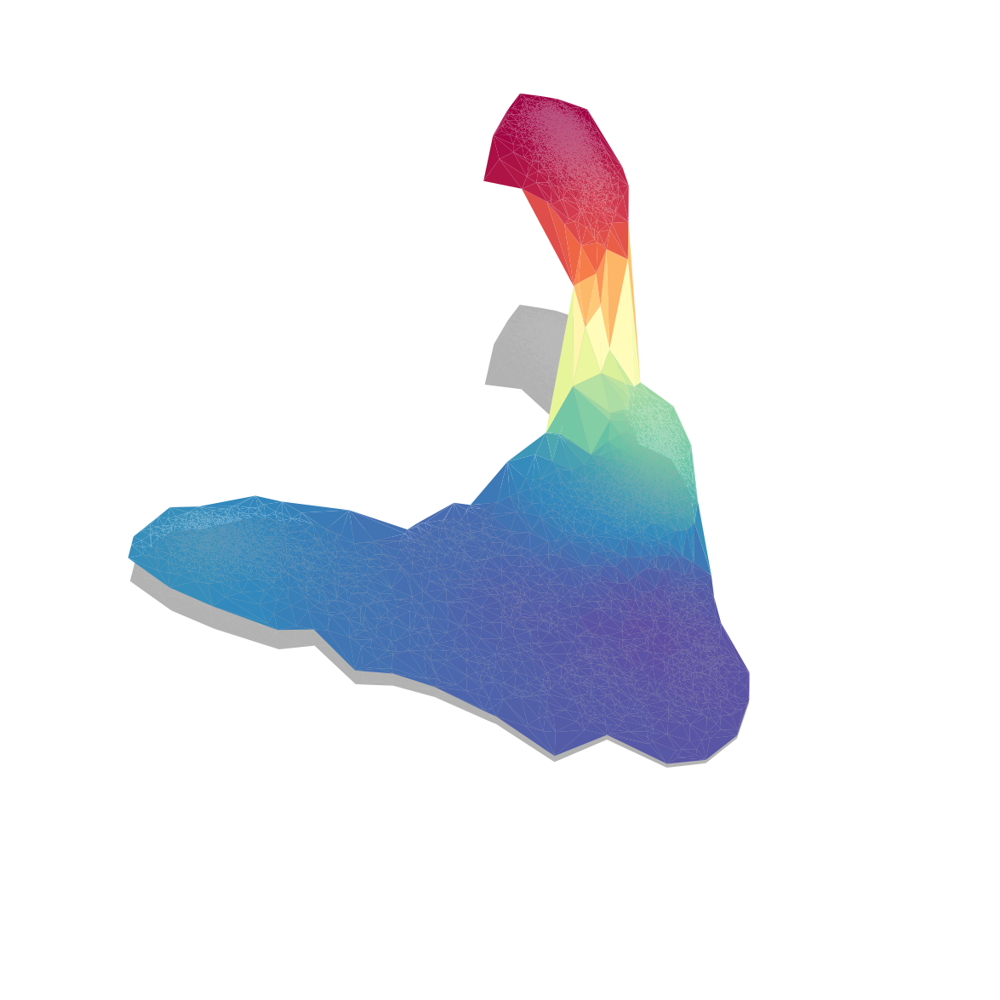

In [19]:
cutedge_vol = 0.01
cutedge_length = 0.01
data_pos = pd.concat(scegot.X_pca[:-1]).values[:, :2]
tri_ = create_graph(
    data_pos,
    cutedge_vol=cutedge_vol,
    cutedge_length=cutedge_length,
    return_type="triangles",
)[0]

fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(111, projection="3d")
ax.plot_trisurf(
    tri_,
    np.repeat(np.min(Wpotential), len(Wpotential)),
    zorder=0,
    color="k",
    alpha=0.3,
    edgecolor="none",
)
ax.plot_trisurf(
    tri_, Wpotential, zorder=2, cmap="Spectral_r", edgecolor="none", alpha=1
)
ax.set_box_aspect(aspect=(1, 1, 0.8))
ax.view_init(elev=50, azim=50)
ax.set_box_aspect([1, 1, 0.5])
ax.set_axis_off()
ax.set_facecolor("white")
fig.savefig("../figure/potential_scEGOT_3d_pca.jpeg", format="jpeg", dpi=300, bbox_inches="tight")

In [20]:
# CytoTRACE2_Relative plot

#cutedge_vol = 0.01
#cutedge_length = 0.01
#data_pos = pd.concat(scegot.X_pca[:-1]).values[:, :2]
#tri_ = create_graph(
#    data_pos,
#    cutedge_vol=cutedge_vol,
#    cutedge_length=cutedge_length,
#    return_type="triangles",
#)[0]

#fig = plt.figure(figsize=(15, 15))
#ax = fig.add_subplot(111, projection="3d")
#ax.plot_trisurf(
#    tri_,
#    np.repeat(
#       np.min(
#            cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])]
#        ),
#        len(cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])]),
#    ),
#    zorder=0,
#    color="k",
#    alpha=0.3,
#    edgecolor="none",
#)
#ax.plot_trisurf(
#    tri_,
#    cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])],
#    zorder=2,
#    cmap="Spectral_r",
#    edgecolor="none",
#    alpha=1,
#)
#ax.set_box_aspect(aspect=(1, 1, 0.8))
#ax.view_init(elev=50, azim=50)
#ax.set_box_aspect([1, 1, 0.5])
#ax.set_axis_off()
#ax.set_facecolor("white")
#fig.savefig("../figure/potential_CytoTRACE2_3d_pca.jpeg", format="jpeg", dpi=300, bbox_inches="tight")

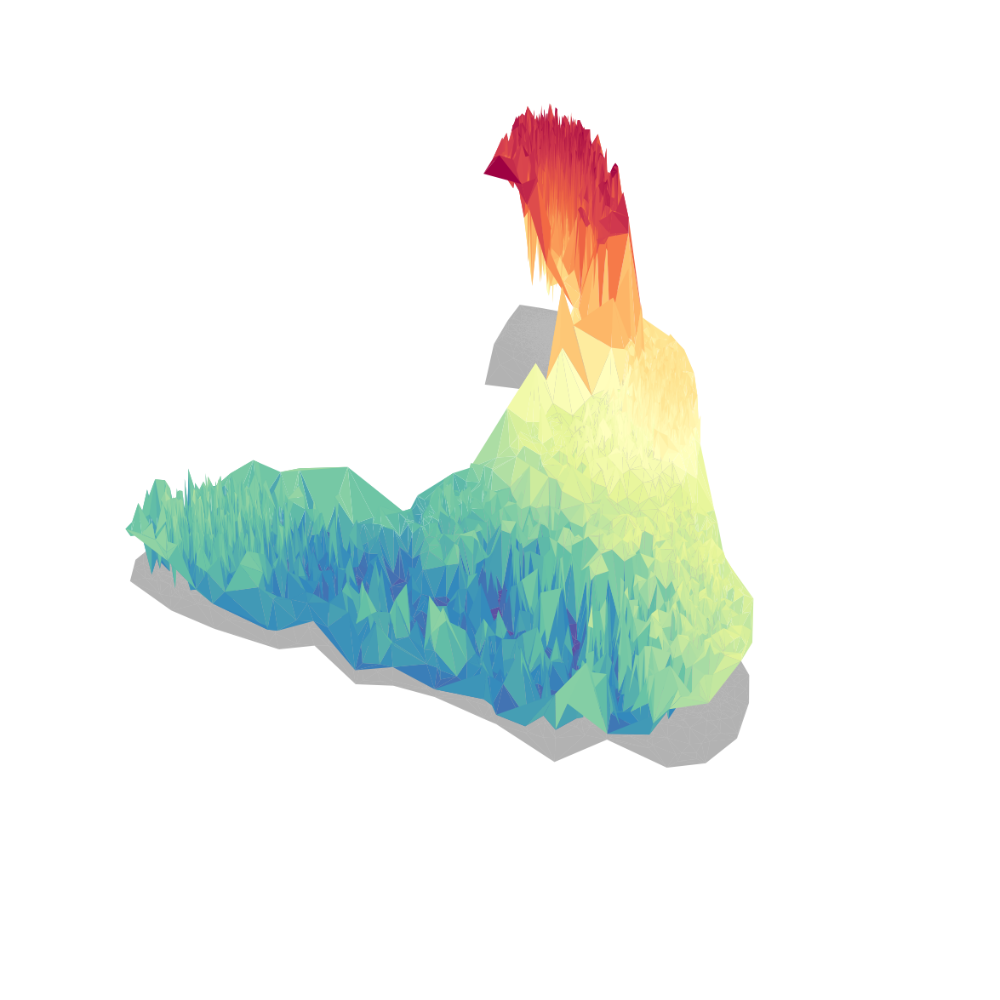

In [21]:
# 1 - CytoTRACE2_Relative plot

cutedge_vol = 0.01
cutedge_length = 0.01
data_pos = pd.concat(scegot.X_pca[:-1]).values[:, :2]
tri_ = create_graph(
    data_pos,
    cutedge_vol=cutedge_vol,
    cutedge_length=cutedge_length,
    return_type="triangles",
)[0]

fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(111, projection="3d")
ax.plot_trisurf(
    tri_,
    np.repeat(
        np.min(
            1 - cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])]
        ),
        len(
            1 - cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])]
        ),
    ),
    zorder=0,
    color="k",
    alpha=0.3,
    edgecolor="none",
)
ax.plot_trisurf(
    tri_,
    1 - cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])],
    zorder=2,
    cmap="Spectral_r",
    edgecolor="none",
    alpha=1,
)
ax.set_box_aspect(aspect=(1, 1, 0.8))
ax.view_init(elev=50, azim=50)
ax.set_box_aspect([1, 1, 0.5])
ax.set_axis_off()
ax.set_facecolor("white")
fig.savefig("../figure/potential_CytoTRACE2_3d_pca.jpeg", format="jpeg", dpi=300, bbox_inches="tight")

##### UMAP

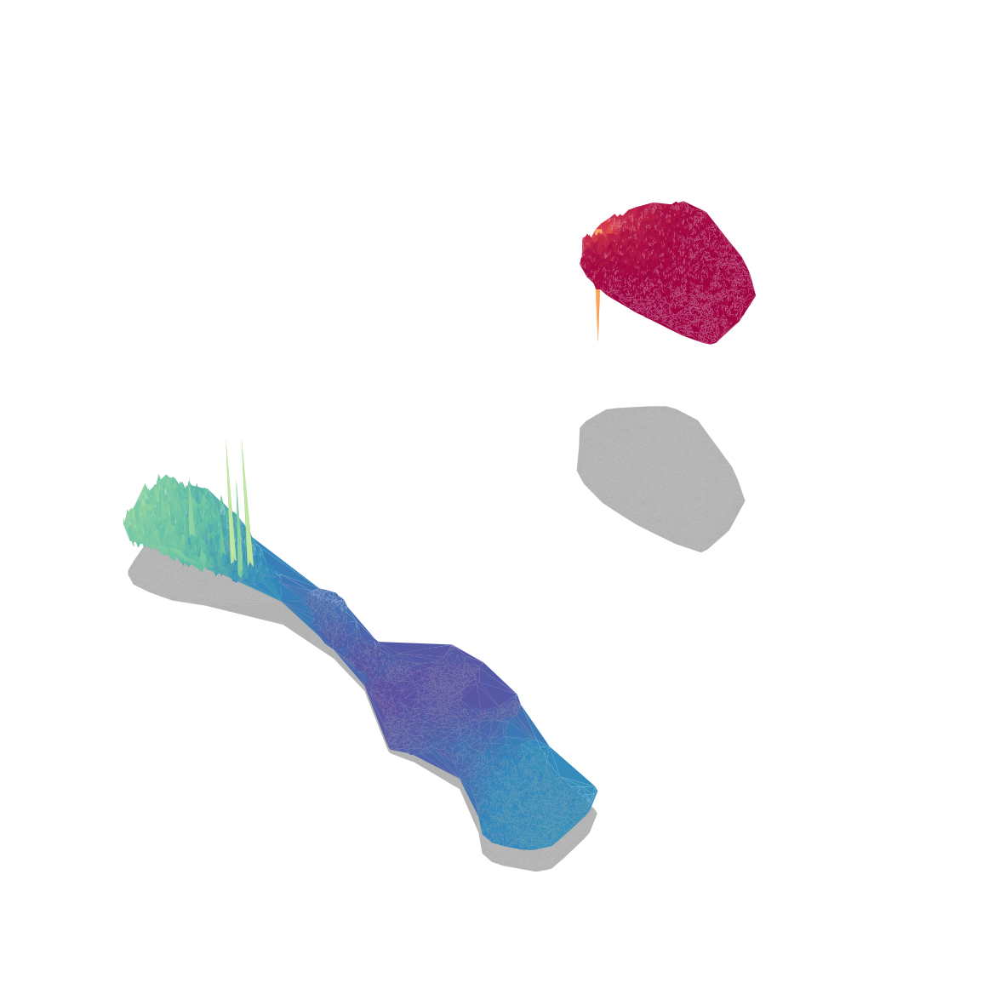

In [22]:
cutedge_vol = 0.01
cutedge_length = 0.01
data_pos = pd.concat(scegot.X_umap[:-1]).values[:, :2]
tri_ = create_graph(
    data_pos,
    cutedge_vol=cutedge_vol,
    cutedge_length=cutedge_length,
    return_type="triangles",
)[0]

fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(111, projection="3d")
ax.plot_trisurf(
    tri_,
    np.repeat(np.min(Wpotential), len(Wpotential)),
    zorder=0,
    color="k",
    alpha=0.3,
    edgecolor="none",
)
ax.plot_trisurf(
    tri_, Wpotential, zorder=2, cmap="Spectral_r", edgecolor="none", alpha=1
)
ax.set_box_aspect(aspect=(1, 1, 0.8))
ax.view_init(elev=50, azim=50)
ax.set_box_aspect([1, 1, 0.5])
ax.set_axis_off()
ax.set_facecolor("white")
# fig.savefig(f"{out_dir}/Fig_potential_3d.png", bbox_inches="tight", dpi=200)

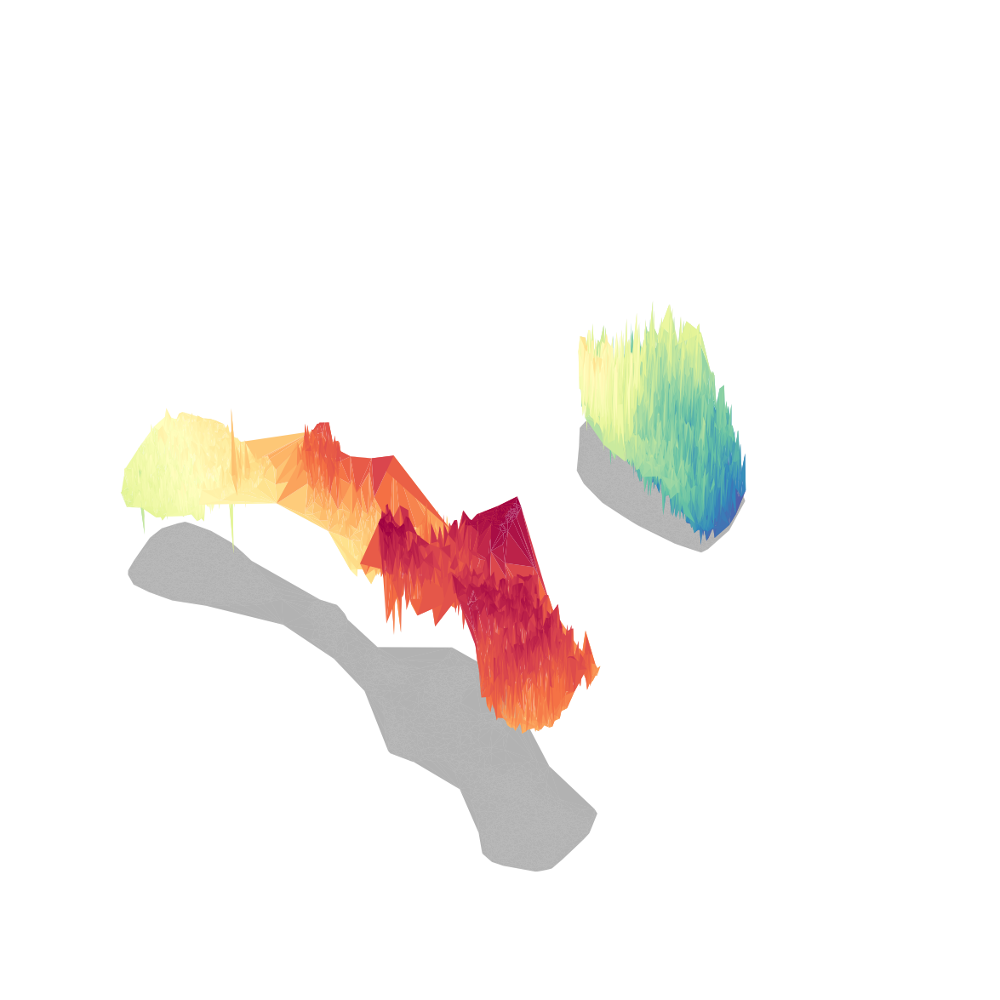

In [23]:
# CytoTRACE2_Relative plot

#cutedge_vol = 0.01
#cutedge_length = 0.01
#data_pos = pd.concat(scegot.X_umap[:-1]).values[:, :2]
#tri_ = create_graph(
#    data_pos,
#    cutedge_vol=cutedge_vol,
#    cutedge_length=cutedge_length,
#    return_type="triangles",
#)[0]
#
#fig = plt.figure(figsize=(15, 15))
#ax = fig.add_subplot(111, projection="3d")
#ax.plot_trisurf(
#    tri_,
#    np.repeat(
#        np.min(
#            cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])]
#        ),
#        len(cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])]),
#    ),
#    zorder=0,
#    color="k",
#    alpha=0.3,
#    edgecolor="none",
#)
#ax.plot_trisurf(
#    tri_,
#    cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])],
#    zorder=2,
#    cmap="Spectral_r",
#    edgecolor="none",
#    alpha=1,
#)
#ax.set_box_aspect(aspect=(1, 1, 0.8))
#ax.view_init(elev=50, azim=50)
#ax.set_box_aspect([1, 1, 0.5])
#ax.set_axis_off()
#ax.set_facecolor("white")
# fig.savefig(f"{out_dir}/Fig_potential_3d.png", bbox_inches="tight", dpi=200)

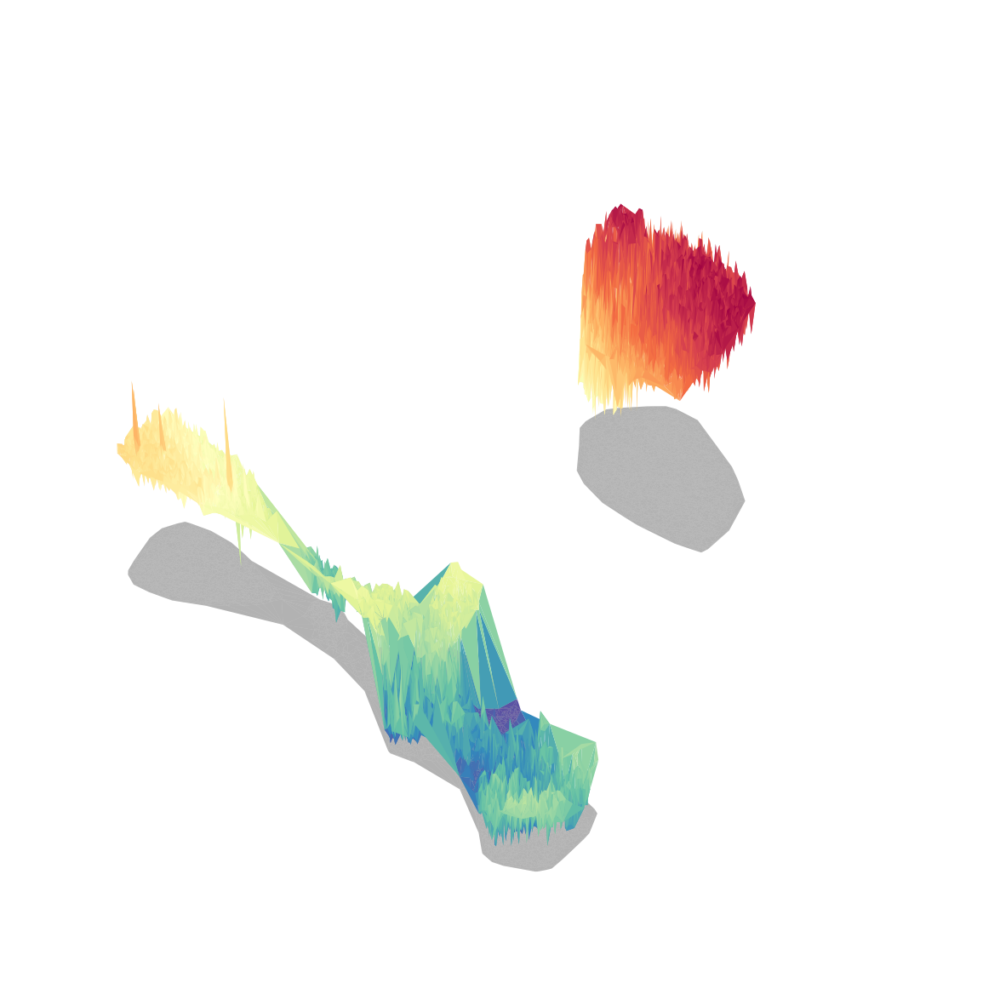

In [24]:
# 1 - CytoTRACE2_Relative をプロット

cutedge_vol = 0.01
cutedge_length = 0.01
data_pos = pd.concat(scegot.X_umap[:-1]).values[:, :2]
tri_ = create_graph(
    data_pos,
    cutedge_vol=cutedge_vol,
    cutedge_length=cutedge_length,
    return_type="triangles",
)[0]

fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(111, projection="3d")
ax.plot_trisurf(
    tri_,
    np.repeat(
        np.min(
            1 - cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])]
        ),
        len(
            1 - cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])]
        ),
    ),
    zorder=0,
    color="k",
    alpha=0.3,
    edgecolor="none",
)
ax.plot_trisurf(
    tri_,
    1 - cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])],
    zorder=2,
    cmap="Spectral_r",
    edgecolor="none",
    alpha=1,
)
ax.set_box_aspect(aspect=(1, 1, 0.8))
ax.view_init(elev=50, azim=50)
ax.set_box_aspect([1, 1, 0.5])
ax.set_axis_off()
ax.set_facecolor("white")
# fig.savefig(f"{out_dir}/Fig_potential_3d.png", bbox_inches="tight", dpi=200)

#### 3-d（scEGOT tutorial ver.）

##### PCA

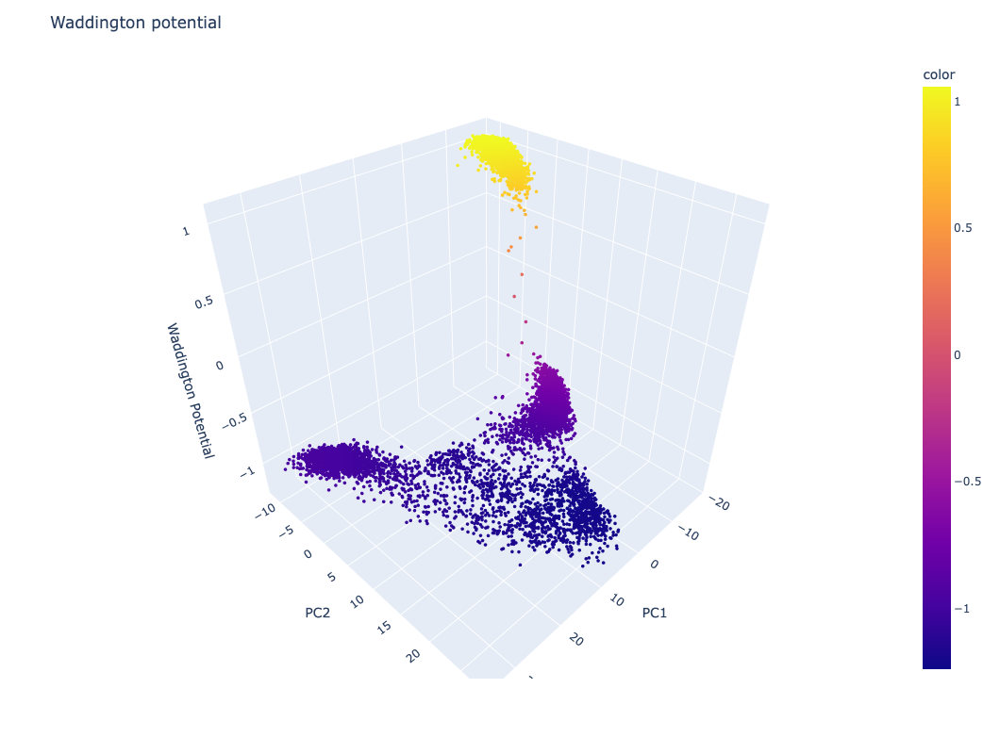

In [25]:
scegot.plot_waddington_potential(
    Wpotential,
    mode="pca",
    gene_name=None,
    # save=True,
    # save_path="./waddington_potential_umap_potential.html"
)

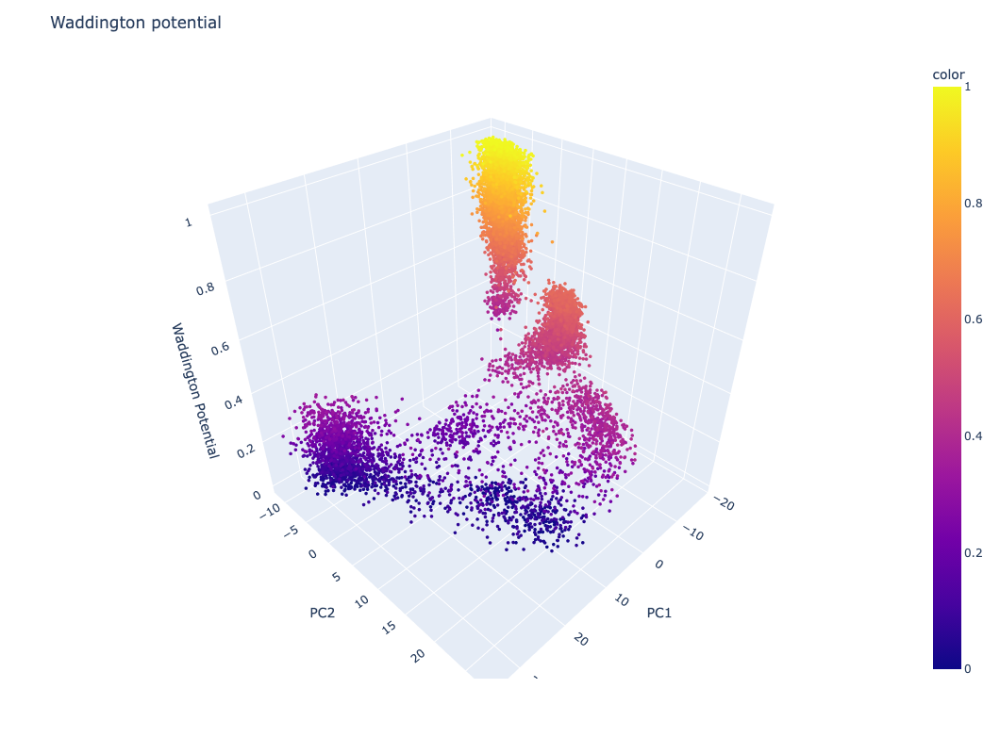

In [26]:
#scegot.plot_waddington_potential(
#    cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])].values,
#    mode="pca",
#    gene_name=None,
    # save=True,
    # save_path="./waddington_potential_umap_potential.html"
#)

scegot.plot_waddington_potential(
    1 - cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])].values,
    mode="pca",
    gene_name=None,
    # save=True,
    # save_path="./waddington_potential_umap_potential.html"
)

##### UMAP

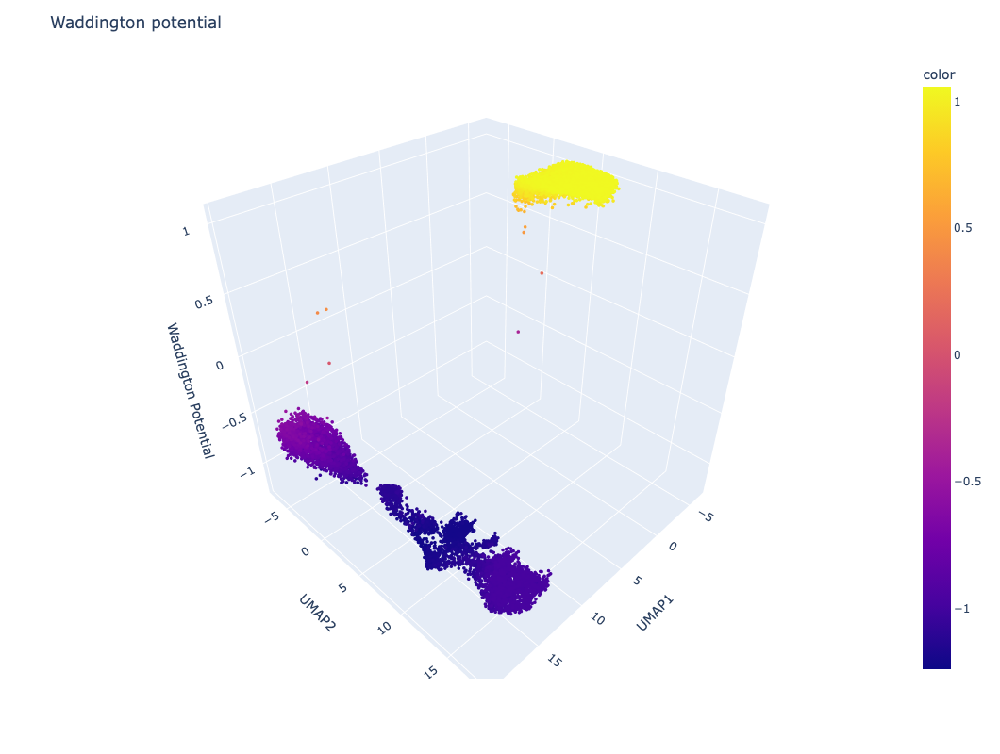

In [27]:
scegot.plot_waddington_potential(
    Wpotential,
    mode="umap",
    gene_name=None,
    # save=True,
    # save_path="./waddington_potential_umap_potential.html"
)

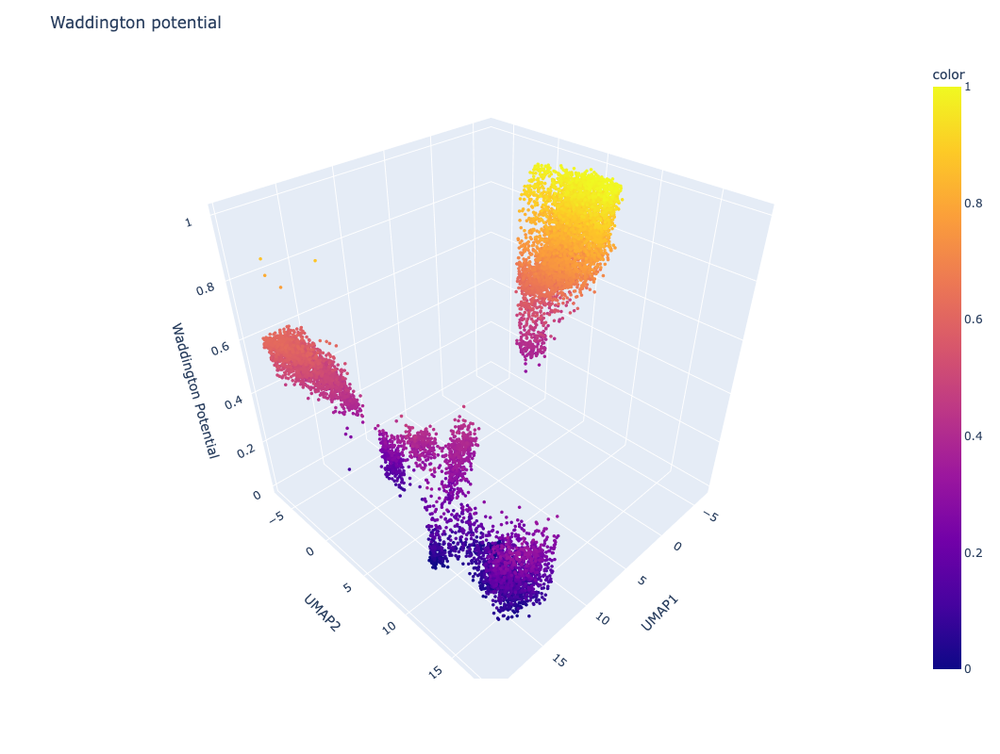

In [28]:
#scegot.plot_waddington_potential(
#    cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])].values,
#    mode="umap",
#    gene_name=None,
    # save=True,
    # save_path="./waddington_potential_umap_potential.html"
#)

scegot.plot_waddington_potential(
    1 - cytotrace2_results["CytoTRACE2_Relative"].iloc[: -len(scegot.X_pca[-1])].values,
    mode="umap",
    gene_name=None,
    # save=True,
    # save_path="./waddington_potential_umap_potential.html"
)